In [ ]:
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from __future__ import print_function

In [1]:
# Set random seem for reproducibility
manualSeed = 999
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [2]:
# Root directory for dataset
dataroot = "/home/ubuntu/DL/data/"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 128

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 200

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

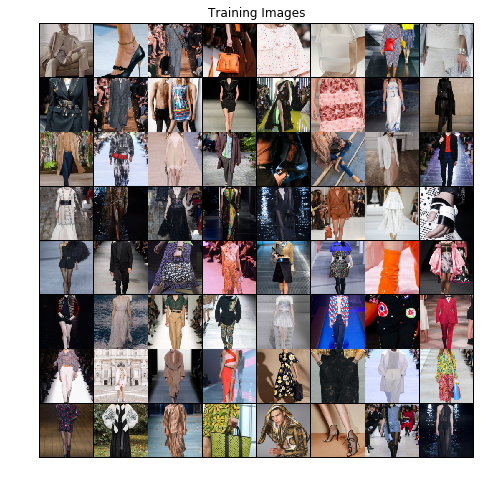

In [3]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [4]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [5]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(     nz, ngf * 16, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 16),
            nn.ReLU(True),
            # state size. (ngf*16) x 4 x 4
            nn.ConvTranspose2d(ngf * 16, ngf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 8 x 8
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 16 x 16 
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 32 x 32
            nn.ConvTranspose2d(ngf * 2,     ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 64 x 64
            nn.ConvTranspose2d(    ngf,      nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 128 x 128
        )

    def forward(self, input):
        return self.main(input)

In [6]:
# Create the generator
netG = Generator(ngpu).to(device)

# Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace)
    (12): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): BatchNorm2d(64, eps=1e-05,

In [7]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
             # input is (nc) x 128 x 128
            nn.Conv2d(nc, ndf, 4, stride=2, padding=1, bias=False), 
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 64 x 64
            nn.Conv2d(ndf, ndf * 2, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 32 x 32
            nn.Conv2d(ndf * 2, ndf * 4, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 16 x 16 
            nn.Conv2d(ndf * 4, ndf * 8, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 8 x 8
            nn.Conv2d(ndf * 8, ndf * 16, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*16) x 4 x 4
            nn.Conv2d(ndf * 16, 1, 4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
            # state size. 1
        )

    def forward(self, input):
        return self.main(input)

In [8]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)


# Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace)
    (11): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affi

In [9]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [10]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
#         print("b_size ", b_size)
        label = torch.full((b_size,), real_label, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
#         print("output ", output.shape)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/200][0/79]	Loss_D: 1.8341	Loss_G: 12.9940	D(x): 0.4568	D(G(z)): 0.4347 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[0/200][50/79]	Loss_D: 0.0008	Loss_G: 51.7113	D(x): 0.9992	D(G(z)): 0.0000 / 0.0000
[1/200][0/79]	Loss_D: 0.0001	Loss_G: 51.1202	D(x): 0.9999	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[1/200][50/79]	Loss_D: 0.0001	Loss_G: 51.0054	D(x): 0.9999	D(G(z)): 0.0000 / 0.0000
[2/200][0/79]	Loss_D: 0.0001	Loss_G: 50.8020	D(x): 0.9999	D(G(z)): 0.0000 / 0.0000
[2/200][50/79]	Loss_D: 0.0001	Loss_G: 50.8151	D(x): 0.9999	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[3/200][0/79]	Loss_D: 0.0000	Loss_G: 50.8813	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[3/200][50/79]	Loss_D: 0.0000	Loss_G: 50.7292	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[4/200][0/79]	Loss_D: 0.0000	Loss_G: 50.6941	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[4/200][50/79]	Loss_D: 0.0000	Loss_G: 50.5199	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[5/200][0/79]	Loss_D: 0.0000	Loss_G: 50.3691	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[5/200][50/79]	Loss_D: 0.0000	Loss_G: 50.6645	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[6/200][0/79]	Loss_D: 0.0000	Loss_G: 50.5731	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[6/200][50/79]	Loss_D: 0.0000	Loss_G: 50.2214	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[7/200][0/79]	Loss_D: 0.0000	Loss_G: 50.3638	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[7/200][50/79]	Loss_D: 0.0000	Loss_G: 50.2351	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[8/200][0/79]	Loss_D: 0.0000	Loss_G: 50.2245	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[8/200][50/79]	Loss_D: 0.0000	Loss_G: 50.4327	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')
/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[9/200][0/79]	Loss_D: 0.0000	Loss_G: 50.1544	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[9/200][50/79]	Loss_D: 0.0000	Loss_G: 50.3872	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[10/200][0/79]	Loss_D: 0.0000	Loss_G: 50.1319	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[10/200][50/79]	Loss_D: 0.0000	Loss_G: 50.1088	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[11/200][0/79]	Loss_D: 0.0000	Loss_G: 50.0873	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[11/200][50/79]	Loss_D: 0.0000	Loss_G: 50.1348	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[12/200][0/79]	Loss_D: 0.0000	Loss_G: 49.8623	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[12/200][50/79]	Loss_D: 0.0000	Loss_G: 49.9652	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[13/200][0/79]	Loss_D: 0.0000	Loss_G: 49.9997	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[13/200][50/79]	Loss_D: 0.0000	Loss_G: 50.1192	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[14/200][0/79]	Loss_D: 0.0000	Loss_G: 50.2061	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[14/200][50/79]	Loss_D: 0.0000	Loss_G: 50.0465	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[15/200][0/79]	Loss_D: 0.0000	Loss_G: 49.9142	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[15/200][50/79]	Loss_D: 0.0000	Loss_G: 49.8184	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[16/200][0/79]	Loss_D: 0.0000	Loss_G: 49.8264	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[16/200][50/79]	Loss_D: 0.0000	Loss_G: 49.9196	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[17/200][0/79]	Loss_D: 0.0000	Loss_G: 49.6654	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[17/200][50/79]	Loss_D: 0.0000	Loss_G: 49.9135	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[18/200][0/79]	Loss_D: 0.0000	Loss_G: 49.8743	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[18/200][50/79]	Loss_D: 0.0000	Loss_G: 49.8813	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[19/200][0/79]	Loss_D: 0.0000	Loss_G: 49.9011	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[19/200][50/79]	Loss_D: 0.0000	Loss_G: 49.6727	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[20/200][0/79]	Loss_D: 0.0000	Loss_G: 49.9500	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[20/200][50/79]	Loss_D: 0.0000	Loss_G: 49.8034	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[21/200][0/79]	Loss_D: 0.0000	Loss_G: 49.7652	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[21/200][50/79]	Loss_D: 0.0000	Loss_G: 49.8089	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[22/200][0/79]	Loss_D: 0.0000	Loss_G: 49.8414	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[22/200][50/79]	Loss_D: 0.0000	Loss_G: 49.7957	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[23/200][0/79]	Loss_D: 0.0000	Loss_G: 49.4780	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[23/200][50/79]	Loss_D: 0.0000	Loss_G: 49.6734	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[24/200][0/79]	Loss_D: 0.0000	Loss_G: 49.5187	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[24/200][50/79]	Loss_D: 0.0000	Loss_G: 49.6107	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[25/200][0/79]	Loss_D: 0.0000	Loss_G: 49.4833	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[25/200][50/79]	Loss_D: 0.0000	Loss_G: 49.6003	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[26/200][0/79]	Loss_D: 0.0000	Loss_G: 49.6696	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[26/200][50/79]	Loss_D: 0.0000	Loss_G: 49.5318	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[27/200][0/79]	Loss_D: 0.0000	Loss_G: 49.6455	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[27/200][50/79]	Loss_D: 0.0000	Loss_G: 49.5465	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[28/200][0/79]	Loss_D: 0.0000	Loss_G: 49.6197	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[28/200][50/79]	Loss_D: 0.0000	Loss_G: 49.5939	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[29/200][0/79]	Loss_D: 0.0000	Loss_G: 49.3710	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[29/200][50/79]	Loss_D: 0.0000	Loss_G: 49.3443	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[30/200][0/79]	Loss_D: 0.0000	Loss_G: 49.5311	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[30/200][50/79]	Loss_D: 0.0000	Loss_G: 49.5571	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[31/200][0/79]	Loss_D: 0.0000	Loss_G: 49.2866	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[31/200][50/79]	Loss_D: 0.0000	Loss_G: 49.4682	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[32/200][0/79]	Loss_D: 0.0000	Loss_G: 49.4353	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[32/200][50/79]	Loss_D: 0.0000	Loss_G: 49.6150	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[33/200][0/79]	Loss_D: 0.0000	Loss_G: 49.4703	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[33/200][50/79]	Loss_D: 0.0000	Loss_G: 49.3592	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[34/200][0/79]	Loss_D: 0.0000	Loss_G: 49.4024	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[34/200][50/79]	Loss_D: 0.0000	Loss_G: 49.3957	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[35/200][0/79]	Loss_D: 0.0000	Loss_G: 49.2248	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[35/200][50/79]	Loss_D: 0.0000	Loss_G: 49.2973	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[36/200][0/79]	Loss_D: 0.0000	Loss_G: 49.4565	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[36/200][50/79]	Loss_D: 0.0000	Loss_G: 49.3073	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[37/200][0/79]	Loss_D: 0.0000	Loss_G: 49.2531	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[37/200][50/79]	Loss_D: 0.0000	Loss_G: 49.3442	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[38/200][0/79]	Loss_D: 0.0000	Loss_G: 49.0991	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[38/200][50/79]	Loss_D: 0.0000	Loss_G: 49.1604	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[39/200][0/79]	Loss_D: 0.0000	Loss_G: 49.2516	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[39/200][50/79]	Loss_D: 0.0000	Loss_G: 49.4862	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[40/200][0/79]	Loss_D: 0.0000	Loss_G: 49.3273	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[40/200][50/79]	Loss_D: 0.0000	Loss_G: 49.3194	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[41/200][0/79]	Loss_D: 0.0000	Loss_G: 49.0558	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[41/200][50/79]	Loss_D: 0.0000	Loss_G: 49.0840	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[42/200][0/79]	Loss_D: 0.0000	Loss_G: 49.1502	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[42/200][50/79]	Loss_D: 0.0000	Loss_G: 49.1335	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[43/200][0/79]	Loss_D: 0.0000	Loss_G: 49.2319	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[43/200][50/79]	Loss_D: 0.0000	Loss_G: 49.3773	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[44/200][0/79]	Loss_D: 0.0000	Loss_G: 49.3244	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[44/200][50/79]	Loss_D: 0.0000	Loss_G: 49.2720	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[45/200][0/79]	Loss_D: 0.0000	Loss_G: 49.0182	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[45/200][50/79]	Loss_D: 0.0000	Loss_G: 49.1796	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[46/200][0/79]	Loss_D: 0.0000	Loss_G: 49.1607	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[46/200][50/79]	Loss_D: 0.0000	Loss_G: 49.2268	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[47/200][0/79]	Loss_D: 0.0000	Loss_G: 48.9716	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[47/200][50/79]	Loss_D: 0.0000	Loss_G: 49.1044	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[48/200][0/79]	Loss_D: 0.0000	Loss_G: 48.9452	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[48/200][50/79]	Loss_D: 0.0000	Loss_G: 49.1218	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[49/200][0/79]	Loss_D: 0.0000	Loss_G: 49.0593	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[49/200][50/79]	Loss_D: 0.0000	Loss_G: 48.9927	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[50/200][0/79]	Loss_D: 0.0000	Loss_G: 49.0149	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[50/200][50/79]	Loss_D: 0.0000	Loss_G: 49.1578	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[51/200][0/79]	Loss_D: 0.0000	Loss_G: 48.8675	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[51/200][50/79]	Loss_D: 0.0000	Loss_G: 49.0031	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[52/200][0/79]	Loss_D: 0.0000	Loss_G: 49.0408	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[52/200][50/79]	Loss_D: 0.0000	Loss_G: 49.0326	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[53/200][0/79]	Loss_D: 0.0000	Loss_G: 49.1323	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[53/200][50/79]	Loss_D: 0.0000	Loss_G: 48.8942	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[54/200][0/79]	Loss_D: 0.0000	Loss_G: 48.8136	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[54/200][50/79]	Loss_D: 0.0000	Loss_G: 48.8384	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[55/200][0/79]	Loss_D: 0.0000	Loss_G: 48.6651	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[55/200][50/79]	Loss_D: 0.0000	Loss_G: 48.8218	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[56/200][0/79]	Loss_D: 0.0000	Loss_G: 48.6987	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[56/200][50/79]	Loss_D: 0.0000	Loss_G: 48.6826	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[57/200][0/79]	Loss_D: 0.0000	Loss_G: 48.7613	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[57/200][50/79]	Loss_D: 0.0000	Loss_G: 48.9738	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[58/200][0/79]	Loss_D: 0.0000	Loss_G: 48.8602	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[58/200][50/79]	Loss_D: 0.0000	Loss_G: 48.8376	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[59/200][0/79]	Loss_D: 0.0000	Loss_G: 48.8649	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[59/200][50/79]	Loss_D: 0.0000	Loss_G: 48.7179	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[60/200][0/79]	Loss_D: 0.0000	Loss_G: 48.7784	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[60/200][50/79]	Loss_D: 0.0000	Loss_G: 48.7268	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[61/200][0/79]	Loss_D: 0.0000	Loss_G: 48.6173	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[61/200][50/79]	Loss_D: 0.0000	Loss_G: 48.6194	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[62/200][0/79]	Loss_D: 0.0000	Loss_G: 48.7957	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[62/200][50/79]	Loss_D: 0.0000	Loss_G: 48.6114	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[63/200][0/79]	Loss_D: 0.0000	Loss_G: 48.8548	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[63/200][50/79]	Loss_D: 0.0000	Loss_G: 48.7176	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[64/200][0/79]	Loss_D: 0.0000	Loss_G: 48.7681	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[64/200][50/79]	Loss_D: 0.0000	Loss_G: 48.4245	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[65/200][0/79]	Loss_D: 0.0000	Loss_G: 48.4563	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[65/200][50/79]	Loss_D: 0.0000	Loss_G: 48.5376	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[66/200][0/79]	Loss_D: 0.0000	Loss_G: 48.6027	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[66/200][50/79]	Loss_D: 0.0000	Loss_G: 48.5847	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[67/200][0/79]	Loss_D: 0.0000	Loss_G: 48.4276	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[67/200][50/79]	Loss_D: 0.0000	Loss_G: 48.4380	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[68/200][0/79]	Loss_D: 0.0000	Loss_G: 48.4508	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[68/200][50/79]	Loss_D: 0.0000	Loss_G: 48.3885	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[69/200][0/79]	Loss_D: 0.0000	Loss_G: 48.3907	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[69/200][50/79]	Loss_D: 0.0000	Loss_G: 48.4525	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[70/200][0/79]	Loss_D: 0.0000	Loss_G: 48.3874	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[70/200][50/79]	Loss_D: 0.0000	Loss_G: 48.1063	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[71/200][0/79]	Loss_D: 0.0000	Loss_G: 48.3459	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[71/200][50/79]	Loss_D: 0.0000	Loss_G: 48.1282	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[72/200][0/79]	Loss_D: 0.0000	Loss_G: 48.3907	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[72/200][50/79]	Loss_D: 0.0000	Loss_G: 48.1793	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[73/200][0/79]	Loss_D: 0.0000	Loss_G: 48.1849	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[73/200][50/79]	Loss_D: 0.0000	Loss_G: 48.0611	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[74/200][0/79]	Loss_D: 0.0000	Loss_G: 48.1986	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[74/200][50/79]	Loss_D: 0.0000	Loss_G: 47.9613	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[75/200][0/79]	Loss_D: 0.0000	Loss_G: 48.1254	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[75/200][50/79]	Loss_D: 0.0000	Loss_G: 48.1203	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[76/200][0/79]	Loss_D: 0.0000	Loss_G: 47.8936	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[76/200][50/79]	Loss_D: 0.0000	Loss_G: 48.0559	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[77/200][0/79]	Loss_D: 0.0000	Loss_G: 48.0819	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[77/200][50/79]	Loss_D: 0.0000	Loss_G: 47.9196	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[78/200][0/79]	Loss_D: 0.0000	Loss_G: 47.9773	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[78/200][50/79]	Loss_D: 0.0000	Loss_G: 47.7432	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[79/200][0/79]	Loss_D: 0.0000	Loss_G: 47.6789	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[79/200][50/79]	Loss_D: 0.0000	Loss_G: 47.4073	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[80/200][0/79]	Loss_D: 0.0000	Loss_G: 47.5368	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[80/200][50/79]	Loss_D: 0.0000	Loss_G: 47.6191	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[81/200][0/79]	Loss_D: 0.0000	Loss_G: 47.4932	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[81/200][50/79]	Loss_D: 0.0000	Loss_G: 47.3548	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[82/200][0/79]	Loss_D: 0.0000	Loss_G: 47.2436	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[82/200][50/79]	Loss_D: 0.0000	Loss_G: 47.0810	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[83/200][0/79]	Loss_D: 0.0000	Loss_G: 46.9758	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[83/200][50/79]	Loss_D: 0.0000	Loss_G: 46.8200	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[84/200][0/79]	Loss_D: 0.0000	Loss_G: 46.7282	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[84/200][50/79]	Loss_D: 0.0000	Loss_G: 46.5504	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[85/200][0/79]	Loss_D: 0.0000	Loss_G: 46.3277	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[85/200][50/79]	Loss_D: 0.0000	Loss_G: 45.8979	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[86/200][0/79]	Loss_D: 0.0000	Loss_G: 45.7235	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[86/200][50/79]	Loss_D: 0.0000	Loss_G: 42.7912	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[87/200][0/79]	Loss_D: 3.2252	Loss_G: 4.3126	D(x): 0.7757	D(G(z)): 0.4926 / 0.4072


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[87/200][50/79]	Loss_D: 1.3970	Loss_G: 1.4723	D(x): 0.5675	D(G(z)): 0.2534 / 0.3264
[88/200][0/79]	Loss_D: 1.3778	Loss_G: 2.9219	D(x): 0.6548	D(G(z)): 0.4366 / 0.1884
[88/200][50/79]	Loss_D: 1.3890	Loss_G: 1.4337	D(x): 0.6710	D(G(z)): 0.5487 / 0.3388


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[89/200][0/79]	Loss_D: 0.9194	Loss_G: 2.1334	D(x): 0.7858	D(G(z)): 0.3719 / 0.1775


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[89/200][50/79]	Loss_D: 0.8090	Loss_G: 1.6643	D(x): 0.6248	D(G(z)): 0.1752 / 0.2330
[90/200][0/79]	Loss_D: 1.0323	Loss_G: 2.3253	D(x): 0.6223	D(G(z)): 0.2855 / 0.1268


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[90/200][50/79]	Loss_D: 1.4403	Loss_G: 1.3557	D(x): 0.4178	D(G(z)): 0.1735 / 0.3036
[91/200][0/79]	Loss_D: 1.6730	Loss_G: 1.9565	D(x): 0.6540	D(G(z)): 0.5631 / 0.2524


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[91/200][50/79]	Loss_D: 1.0732	Loss_G: 1.9664	D(x): 0.6858	D(G(z)): 0.3717 / 0.2018
[92/200][0/79]	Loss_D: 1.2128	Loss_G: 2.4229	D(x): 0.7037	D(G(z)): 0.5163 / 0.1695
[92/200][50/79]	Loss_D: 1.2566	Loss_G: 2.4853	D(x): 0.7508	D(G(z)): 0.5153 / 0.1104


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[93/200][0/79]	Loss_D: 1.4951	Loss_G: 4.1486	D(x): 0.8364	D(G(z)): 0.6501 / 0.0267


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[93/200][50/79]	Loss_D: 1.1091	Loss_G: 2.6426	D(x): 0.6167	D(G(z)): 0.2321 / 0.1141
[94/200][0/79]	Loss_D: 0.7791	Loss_G: 3.9431	D(x): 0.7318	D(G(z)): 0.2773 / 0.0473
[94/200][50/79]	Loss_D: 0.8638	Loss_G: 2.1607	D(x): 0.7497	D(G(z)): 0.3730 / 0.1485


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[95/200][0/79]	Loss_D: 1.2776	Loss_G: 1.7606	D(x): 0.5189	D(G(z)): 0.3262 / 0.2131


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[95/200][50/79]	Loss_D: 0.8645	Loss_G: 2.2392	D(x): 0.6034	D(G(z)): 0.2010 / 0.1507
[96/200][0/79]	Loss_D: 0.7777	Loss_G: 2.7933	D(x): 0.7202	D(G(z)): 0.2742 / 0.1155


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[96/200][50/79]	Loss_D: 1.0715	Loss_G: 2.3242	D(x): 0.6021	D(G(z)): 0.3238 / 0.1310
[97/200][0/79]	Loss_D: 1.0984	Loss_G: 2.3203	D(x): 0.6404	D(G(z)): 0.3429 / 0.1497


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[97/200][50/79]	Loss_D: 0.7421	Loss_G: 2.5701	D(x): 0.7141	D(G(z)): 0.2396 / 0.1105
[98/200][0/79]	Loss_D: 0.9359	Loss_G: 2.5659	D(x): 0.6245	D(G(z)): 0.1968 / 0.1350
[98/200][50/79]	Loss_D: 0.9493	Loss_G: 3.5366	D(x): 0.7123	D(G(z)): 0.3530 / 0.0516


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[99/200][0/79]	Loss_D: 0.7226	Loss_G: 3.3299	D(x): 0.7491	D(G(z)): 0.2668 / 0.0558


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[99/200][50/79]	Loss_D: 0.7774	Loss_G: 3.7099	D(x): 0.8798	D(G(z)): 0.4030 / 0.0459
[100/200][0/79]	Loss_D: 0.8709	Loss_G: 1.5216	D(x): 0.7776	D(G(z)): 0.3392 / 0.2981
[100/200][50/79]	Loss_D: 0.8805	Loss_G: 2.5807	D(x): 0.6848	D(G(z)): 0.3056 / 0.1143


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[101/200][0/79]	Loss_D: 0.6832	Loss_G: 2.1395	D(x): 0.6843	D(G(z)): 0.1522 / 0.1718
[101/200][50/79]	Loss_D: 0.7559	Loss_G: 3.4069	D(x): 0.8377	D(G(z)): 0.3477 / 0.0552


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[102/200][0/79]	Loss_D: 0.7148	Loss_G: 4.5131	D(x): 0.8212	D(G(z)): 0.3264 / 0.0186


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[102/200][50/79]	Loss_D: 1.1637	Loss_G: 3.7071	D(x): 0.6633	D(G(z)): 0.3988 / 0.0527
[103/200][0/79]	Loss_D: 0.4583	Loss_G: 3.5263	D(x): 0.8205	D(G(z)): 0.1762 / 0.0463


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[103/200][50/79]	Loss_D: 0.7842	Loss_G: 3.3571	D(x): 0.7021	D(G(z)): 0.2287 / 0.0693
[104/200][0/79]	Loss_D: 0.3391	Loss_G: 2.9272	D(x): 0.8996	D(G(z)): 0.1750 / 0.0835


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[104/200][50/79]	Loss_D: 0.6176	Loss_G: 1.7123	D(x): 0.6504	D(G(z)): 0.0948 / 0.2424
[105/200][0/79]	Loss_D: 0.6507	Loss_G: 3.9191	D(x): 0.8674	D(G(z)): 0.3269 / 0.0418
[105/200][50/79]	Loss_D: 1.4360	Loss_G: 1.6242	D(x): 0.3788	D(G(z)): 0.0359 / 0.2908


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[106/200][0/79]	Loss_D: 0.8538	Loss_G: 4.4778	D(x): 0.7421	D(G(z)): 0.3345 / 0.0314


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[106/200][50/79]	Loss_D: 0.7465	Loss_G: 2.8516	D(x): 0.6689	D(G(z)): 0.1387 / 0.1010
[107/200][0/79]	Loss_D: 1.0662	Loss_G: 4.6724	D(x): 0.7901	D(G(z)): 0.4368 / 0.0226


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[107/200][50/79]	Loss_D: 0.6268	Loss_G: 3.2293	D(x): 0.6456	D(G(z)): 0.0748 / 0.0652
[108/200][0/79]	Loss_D: 1.1615	Loss_G: 5.2832	D(x): 0.9258	D(G(z)): 0.5678 / 0.0117
[108/200][50/79]	Loss_D: 0.8289	Loss_G: 3.0925	D(x): 0.7997	D(G(z)): 0.3601 / 0.0833


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[109/200][0/79]	Loss_D: 0.6282	Loss_G: 3.2740	D(x): 0.6794	D(G(z)): 0.1065 / 0.0675
[109/200][50/79]	Loss_D: 0.5615	Loss_G: 3.1935	D(x): 0.7252	D(G(z)): 0.1244 / 0.0764


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[110/200][0/79]	Loss_D: 0.8025	Loss_G: 2.3075	D(x): 0.6112	D(G(z)): 0.0869 / 0.1827
[110/200][50/79]	Loss_D: 0.4902	Loss_G: 2.6304	D(x): 0.7314	D(G(z)): 0.0890 / 0.1133


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[111/200][0/79]	Loss_D: 0.6858	Loss_G: 4.1740	D(x): 0.7338	D(G(z)): 0.2219 / 0.0384


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[111/200][50/79]	Loss_D: 0.8879	Loss_G: 1.9045	D(x): 0.5304	D(G(z)): 0.0351 / 0.2230
[112/200][0/79]	Loss_D: 0.7392	Loss_G: 2.4623	D(x): 0.7066	D(G(z)): 0.2212 / 0.1357


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[112/200][50/79]	Loss_D: 0.6255	Loss_G: 2.7095	D(x): 0.7016	D(G(z)): 0.1442 / 0.1184
[113/200][0/79]	Loss_D: 0.6684	Loss_G: 2.6535	D(x): 0.7164	D(G(z)): 0.2048 / 0.1051
[113/200][50/79]	Loss_D: 0.8304	Loss_G: 2.6641	D(x): 0.6525	D(G(z)): 0.2044 / 0.1271


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[114/200][0/79]	Loss_D: 0.5875	Loss_G: 4.4971	D(x): 0.9369	D(G(z)): 0.3447 / 0.0262


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[114/200][50/79]	Loss_D: 0.5518	Loss_G: 2.2950	D(x): 0.6831	D(G(z)): 0.0732 / 0.1525
[115/200][0/79]	Loss_D: 0.6048	Loss_G: 5.1396	D(x): 0.8925	D(G(z)): 0.3253 / 0.0122


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[115/200][50/79]	Loss_D: 0.5831	Loss_G: 4.2582	D(x): 0.8608	D(G(z)): 0.2801 / 0.0281
[116/200][0/79]	Loss_D: 0.5775	Loss_G: 3.8698	D(x): 0.8841	D(G(z)): 0.2990 / 0.0480


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[116/200][50/79]	Loss_D: 0.5221	Loss_G: 4.2391	D(x): 0.8531	D(G(z)): 0.2296 / 0.0298
[117/200][0/79]	Loss_D: 0.9027	Loss_G: 4.4974	D(x): 0.8843	D(G(z)): 0.4608 / 0.0327
[117/200][50/79]	Loss_D: 0.6748	Loss_G: 2.5705	D(x): 0.7098	D(G(z)): 0.1980 / 0.1169


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[118/200][0/79]	Loss_D: 0.8977	Loss_G: 4.1240	D(x): 0.7425	D(G(z)): 0.3297 / 0.0321


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[118/200][50/79]	Loss_D: 0.6631	Loss_G: 3.9013	D(x): 0.7846	D(G(z)): 0.2497 / 0.0411
[119/200][0/79]	Loss_D: 0.7957	Loss_G: 3.3784	D(x): 0.8959	D(G(z)): 0.4019 / 0.0736
[119/200][50/79]	Loss_D: 0.5795	Loss_G: 2.0289	D(x): 0.7974	D(G(z)): 0.2164 / 0.2190


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[120/200][0/79]	Loss_D: 0.9110	Loss_G: 2.5112	D(x): 0.5826	D(G(z)): 0.0975 / 0.1493


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[120/200][50/79]	Loss_D: 0.8815	Loss_G: 5.1790	D(x): 0.9135	D(G(z)): 0.4425 / 0.0153
[121/200][0/79]	Loss_D: 1.1702	Loss_G: 6.5804	D(x): 0.8872	D(G(z)): 0.5521 / 0.0034


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[121/200][50/79]	Loss_D: 1.0340	Loss_G: 1.1402	D(x): 0.4595	D(G(z)): 0.0450 / 0.4047
[122/200][0/79]	Loss_D: 0.5222	Loss_G: 3.4942	D(x): 0.7064	D(G(z)): 0.0705 / 0.0614


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[122/200][50/79]	Loss_D: 0.5136	Loss_G: 3.5329	D(x): 0.8360	D(G(z)): 0.2275 / 0.0567
[123/200][0/79]	Loss_D: 2.0042	Loss_G: 0.7610	D(x): 0.2489	D(G(z)): 0.0269 / 0.5881


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[123/200][50/79]	Loss_D: 0.5922	Loss_G: 3.8715	D(x): 0.7727	D(G(z)): 0.2024 / 0.0493


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[124/200][0/79]	Loss_D: 0.4622	Loss_G: 2.7603	D(x): 0.7710	D(G(z)): 0.1003 / 0.1150
[124/200][50/79]	Loss_D: 1.0179	Loss_G: 3.4652	D(x): 0.4706	D(G(z)): 0.0432 / 0.0725
[125/200][0/79]	Loss_D: 0.4211	Loss_G: 3.7438	D(x): 0.8589	D(G(z)): 0.1943 / 0.0448
[125/200][50/79]	Loss_D: 0.4393	Loss_G: 3.7876	D(x): 0.8706	D(G(z)): 0.2109 / 0.0466


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[126/200][0/79]	Loss_D: 0.4390	Loss_G: 2.7912	D(x): 0.7630	D(G(z)): 0.1041 / 0.0982


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[126/200][50/79]	Loss_D: 0.3913	Loss_G: 4.5336	D(x): 0.9251	D(G(z)): 0.2300 / 0.0246
[127/200][0/79]	Loss_D: 0.4203	Loss_G: 4.4313	D(x): 0.8762	D(G(z)): 0.2161 / 0.0212


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[127/200][50/79]	Loss_D: 0.6085	Loss_G: 4.6123	D(x): 0.8730	D(G(z)): 0.3059 / 0.0216
[128/200][0/79]	Loss_D: 0.6829	Loss_G: 5.2900	D(x): 0.9525	D(G(z)): 0.3933 / 0.0111


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[128/200][50/79]	Loss_D: 0.6041	Loss_G: 4.0674	D(x): 0.8545	D(G(z)): 0.3090 / 0.0311
[129/200][0/79]	Loss_D: 0.3561	Loss_G: 3.1184	D(x): 0.8102	D(G(z)): 0.0952 / 0.0833


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[129/200][50/79]	Loss_D: 0.4509	Loss_G: 4.0592	D(x): 0.8518	D(G(z)): 0.1904 / 0.0336


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[130/200][0/79]	Loss_D: 0.4122	Loss_G: 3.7557	D(x): 0.8373	D(G(z)): 0.1672 / 0.0447
[130/200][50/79]	Loss_D: 0.1922	Loss_G: 4.8763	D(x): 0.9134	D(G(z)): 0.0830 / 0.0176
[131/200][0/79]	Loss_D: 1.0790	Loss_G: 1.6218	D(x): 0.4738	D(G(z)): 0.0522 / 0.3028


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[131/200][50/79]	Loss_D: 0.5148	Loss_G: 3.4779	D(x): 0.9494	D(G(z)): 0.2810 / 0.0553
[132/200][0/79]	Loss_D: 0.3502	Loss_G: 3.8690	D(x): 0.8202	D(G(z)): 0.0915 / 0.0412


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[132/200][50/79]	Loss_D: 0.4031	Loss_G: 2.8887	D(x): 0.7869	D(G(z)): 0.1116 / 0.0923
[133/200][0/79]	Loss_D: 0.3619	Loss_G: 2.0471	D(x): 0.7945	D(G(z)): 0.0564 / 0.2305


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[133/200][50/79]	Loss_D: 0.7869	Loss_G: 5.8528	D(x): 0.9622	D(G(z)): 0.4105 / 0.0105
[134/200][0/79]	Loss_D: 1.2727	Loss_G: 5.9135	D(x): 0.9607	D(G(z)): 0.5895 / 0.0111


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[134/200][50/79]	Loss_D: 0.5141	Loss_G: 3.2524	D(x): 0.6805	D(G(z)): 0.0321 / 0.0957
[135/200][0/79]	Loss_D: 1.0738	Loss_G: 6.9349	D(x): 0.9473	D(G(z)): 0.4883 / 0.0062


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[135/200][50/79]	Loss_D: 0.3913	Loss_G: 3.8397	D(x): 0.8809	D(G(z)): 0.1823 / 0.0439
[136/200][0/79]	Loss_D: 0.2104	Loss_G: 3.8464	D(x): 0.9502	D(G(z)): 0.1306 / 0.0471


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[136/200][50/79]	Loss_D: 0.6672	Loss_G: 5.6660	D(x): 0.9048	D(G(z)): 0.3446 / 0.0088
[137/200][0/79]	Loss_D: 0.5302	Loss_G: 2.1357	D(x): 0.6766	D(G(z)): 0.0476 / 0.2058


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[137/200][50/79]	Loss_D: 0.3551	Loss_G: 3.2338	D(x): 0.8375	D(G(z)): 0.0942 / 0.0846
[138/200][0/79]	Loss_D: 1.4816	Loss_G: 8.3962	D(x): 0.9776	D(G(z)): 0.6398 / 0.0006
[138/200][50/79]	Loss_D: 0.9541	Loss_G: 2.8652	D(x): 0.6556	D(G(z)): 0.2853 / 0.1154


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[139/200][0/79]	Loss_D: 0.3082	Loss_G: 3.7739	D(x): 0.8670	D(G(z)): 0.1257 / 0.0436
[139/200][50/79]	Loss_D: 0.2902	Loss_G: 4.2455	D(x): 0.8387	D(G(z)): 0.0697 / 0.0338


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[140/200][0/79]	Loss_D: 0.5743	Loss_G: 5.8373	D(x): 0.9173	D(G(z)): 0.3013 / 0.0092


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[140/200][50/79]	Loss_D: 0.8709	Loss_G: 2.0139	D(x): 0.5131	D(G(z)): 0.0089 / 0.2177
[141/200][0/79]	Loss_D: 0.3862	Loss_G: 4.6334	D(x): 0.9587	D(G(z)): 0.2348 / 0.0249
[141/200][50/79]	Loss_D: 0.3326	Loss_G: 4.0052	D(x): 0.8170	D(G(z)): 0.0734 / 0.0329


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[142/200][0/79]	Loss_D: 0.2777	Loss_G: 4.9715	D(x): 0.8398	D(G(z)): 0.0599 / 0.0180


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[142/200][50/79]	Loss_D: 0.2123	Loss_G: 3.7152	D(x): 0.9359	D(G(z)): 0.1123 / 0.0488
[143/200][0/79]	Loss_D: 0.4410	Loss_G: 2.7250	D(x): 0.7515	D(G(z)): 0.0761 / 0.1098


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[143/200][50/79]	Loss_D: 0.2793	Loss_G: 4.9081	D(x): 0.9279	D(G(z)): 0.1551 / 0.0146
[144/200][0/79]	Loss_D: 0.3463	Loss_G: 3.7899	D(x): 0.7652	D(G(z)): 0.0211 / 0.0594


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[144/200][50/79]	Loss_D: 0.3256	Loss_G: 3.9065	D(x): 0.9151	D(G(z)): 0.1735 / 0.0388
[145/200][0/79]	Loss_D: 1.3474	Loss_G: 7.4048	D(x): 0.9981	D(G(z)): 0.6288 / 0.0022
[145/200][50/79]	Loss_D: 0.6156	Loss_G: 5.1411	D(x): 0.8620	D(G(z)): 0.2800 / 0.0143


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[146/200][0/79]	Loss_D: 0.1886	Loss_G: 2.7424	D(x): 0.8888	D(G(z)): 0.0488 / 0.1302


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[146/200][50/79]	Loss_D: 0.4061	Loss_G: 2.9006	D(x): 0.7882	D(G(z)): 0.0943 / 0.1006
[147/200][0/79]	Loss_D: 0.2322	Loss_G: 4.5823	D(x): 0.8369	D(G(z)): 0.0267 / 0.0307


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[147/200][50/79]	Loss_D: 0.3600	Loss_G: 4.2996	D(x): 0.8858	D(G(z)): 0.1676 / 0.0283
[148/200][0/79]	Loss_D: 0.2730	Loss_G: 3.6878	D(x): 0.8190	D(G(z)): 0.0219 / 0.0587


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[148/200][50/79]	Loss_D: 0.6058	Loss_G: 7.2474	D(x): 0.9383	D(G(z)): 0.3001 / 0.0034
[149/200][0/79]	Loss_D: 0.6577	Loss_G: 5.1869	D(x): 0.9837	D(G(z)): 0.3307 / 0.0235


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[149/200][50/79]	Loss_D: 0.3586	Loss_G: 4.0990	D(x): 0.8972	D(G(z)): 0.1632 / 0.0357
[150/200][0/79]	Loss_D: 0.1439	Loss_G: 4.5954	D(x): 0.9425	D(G(z)): 0.0688 / 0.0242
[150/200][50/79]	Loss_D: 0.2468	Loss_G: 5.0614	D(x): 0.9305	D(G(z)): 0.1097 / 0.0209


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[151/200][0/79]	Loss_D: 0.5283	Loss_G: 6.9178	D(x): 0.9829	D(G(z)): 0.3185 / 0.0021


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[151/200][50/79]	Loss_D: 0.2428	Loss_G: 4.3061	D(x): 0.9270	D(G(z)): 0.1301 / 0.0246
[152/200][0/79]	Loss_D: 0.3207	Loss_G: 4.8132	D(x): 0.7936	D(G(z)): 0.0225 / 0.0387


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[152/200][50/79]	Loss_D: 0.6770	Loss_G: 3.5847	D(x): 0.6638	D(G(z)): 0.0525 / 0.1002
[153/200][0/79]	Loss_D: 0.1811	Loss_G: 5.0995	D(x): 0.8992	D(G(z)): 0.0323 / 0.0148


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[153/200][50/79]	Loss_D: 0.3293	Loss_G: 6.2448	D(x): 0.9588	D(G(z)): 0.1906 / 0.0072
[154/200][0/79]	Loss_D: 0.3305	Loss_G: 4.1989	D(x): 0.8432	D(G(z)): 0.1040 / 0.0411


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[154/200][50/79]	Loss_D: 0.1099	Loss_G: 5.0557	D(x): 0.9546	D(G(z)): 0.0505 / 0.0142
[155/200][0/79]	Loss_D: 1.6700	Loss_G: 3.4363	D(x): 0.9035	D(G(z)): 0.5561 / 0.1139


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[155/200][50/79]	Loss_D: 0.5584	Loss_G: 4.2268	D(x): 0.6429	D(G(z)): 0.0069 / 0.0568
[156/200][0/79]	Loss_D: 0.3186	Loss_G: 3.9596	D(x): 0.8221	D(G(z)): 0.0789 / 0.0373
[156/200][50/79]	Loss_D: 0.3587	Loss_G: 4.1432	D(x): 0.7781	D(G(z)): 0.0325 / 0.0433


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[157/200][0/79]	Loss_D: 0.1569	Loss_G: 4.4405	D(x): 0.9464	D(G(z)): 0.0835 / 0.0264


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[157/200][50/79]	Loss_D: 0.1992	Loss_G: 5.2236	D(x): 0.8546	D(G(z)): 0.0164 / 0.0143
[158/200][0/79]	Loss_D: 0.2369	Loss_G: 5.3577	D(x): 0.8520	D(G(z)): 0.0388 / 0.0172


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[158/200][50/79]	Loss_D: 0.2866	Loss_G: 3.7158	D(x): 0.8167	D(G(z)): 0.0480 / 0.0570
[159/200][0/79]	Loss_D: 0.1291	Loss_G: 4.7602	D(x): 0.9479	D(G(z)): 0.0659 / 0.0214
[159/200][50/79]	Loss_D: 0.5094	Loss_G: 4.2778	D(x): 0.6970	D(G(z)): 0.0197 / 0.0505


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[160/200][0/79]	Loss_D: 2.1304	Loss_G: 7.5966	D(x): 0.9716	D(G(z)): 0.6729 / 0.0148


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[160/200][50/79]	Loss_D: 0.2523	Loss_G: 4.4724	D(x): 0.8488	D(G(z)): 0.0464 / 0.0366
[161/200][0/79]	Loss_D: 0.1589	Loss_G: 4.9934	D(x): 0.9853	D(G(z)): 0.1169 / 0.0170


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[161/200][50/79]	Loss_D: 0.2537	Loss_G: 5.9873	D(x): 0.9381	D(G(z)): 0.1453 / 0.0061
[162/200][0/79]	Loss_D: 0.1190	Loss_G: 4.5577	D(x): 0.9613	D(G(z)): 0.0654 / 0.0298


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[162/200][50/79]	Loss_D: 0.1625	Loss_G: 5.7018	D(x): 0.9427	D(G(z)): 0.0813 / 0.0076
[163/200][0/79]	Loss_D: 0.5160	Loss_G: 3.2297	D(x): 0.7796	D(G(z)): 0.0758 / 0.1576
[163/200][50/79]	Loss_D: 0.1964	Loss_G: 5.7747	D(x): 0.9487	D(G(z)): 0.1045 / 0.0119


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[164/200][0/79]	Loss_D: 0.1469	Loss_G: 5.2822	D(x): 0.9332	D(G(z)): 0.0596 / 0.0139


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[164/200][50/79]	Loss_D: 0.4170	Loss_G: 6.8708	D(x): 0.9759	D(G(z)): 0.2709 / 0.0025
[165/200][0/79]	Loss_D: 0.2361	Loss_G: 5.3090	D(x): 0.9295	D(G(z)): 0.1308 / 0.0104


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[165/200][50/79]	Loss_D: 0.1302	Loss_G: 4.5327	D(x): 0.9418	D(G(z)): 0.0565 / 0.0203
[166/200][0/79]	Loss_D: 0.2053	Loss_G: 5.6868	D(x): 0.9728	D(G(z)): 0.1376 / 0.0091


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[166/200][50/79]	Loss_D: 0.1398	Loss_G: 4.9551	D(x): 0.9319	D(G(z)): 0.0528 / 0.0166
[167/200][0/79]	Loss_D: 1.3594	Loss_G: 9.9048	D(x): 0.9896	D(G(z)): 0.5964 / 0.0006


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[167/200][50/79]	Loss_D: 0.2727	Loss_G: 2.3481	D(x): 0.8556	D(G(z)): 0.0560 / 0.1726
[168/200][0/79]	Loss_D: 0.2401	Loss_G: 4.6841	D(x): 0.8878	D(G(z)): 0.0669 / 0.0240
[168/200][50/79]	Loss_D: 0.4159	Loss_G: 7.1179	D(x): 0.9759	D(G(z)): 0.2591 / 0.0024


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[169/200][0/79]	Loss_D: 0.1318	Loss_G: 4.9094	D(x): 0.9148	D(G(z)): 0.0339 / 0.0164
[169/200][50/79]	Loss_D: 0.2634	Loss_G: 6.2575	D(x): 0.9613	D(G(z)): 0.1535 / 0.0068


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[170/200][0/79]	Loss_D: 0.1381	Loss_G: 4.6466	D(x): 0.9330	D(G(z)): 0.0576 / 0.0210
[170/200][50/79]	Loss_D: 0.5624	Loss_G: 7.3808	D(x): 0.9720	D(G(z)): 0.2935 / 0.0016


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[171/200][0/79]	Loss_D: 0.2703	Loss_G: 3.7029	D(x): 0.8923	D(G(z)): 0.1054 / 0.0532
[171/200][50/79]	Loss_D: 0.2621	Loss_G: 2.8376	D(x): 0.8214	D(G(z)): 0.0310 / 0.1152


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[172/200][0/79]	Loss_D: 0.2018	Loss_G: 4.9315	D(x): 0.8724	D(G(z)): 0.0403 / 0.0236
[172/200][50/79]	Loss_D: 0.2516	Loss_G: 3.6114	D(x): 0.8315	D(G(z)): 0.0363 / 0.0576


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[173/200][0/79]	Loss_D: 0.2372	Loss_G: 3.9863	D(x): 0.8599	D(G(z)): 0.0524 / 0.0492


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[173/200][50/79]	Loss_D: 0.1739	Loss_G: 3.9181	D(x): 0.8813	D(G(z)): 0.0254 / 0.0478
[174/200][0/79]	Loss_D: 0.1726	Loss_G: 5.6151	D(x): 0.9744	D(G(z)): 0.1138 / 0.0076
[174/200][50/79]	Loss_D: 0.6366	Loss_G: 8.3838	D(x): 0.9749	D(G(z)): 0.3799 / 0.0007


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[175/200][0/79]	Loss_D: 0.1714	Loss_G: 4.2212	D(x): 0.8697	D(G(z)): 0.0159 / 0.0330


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[175/200][50/79]	Loss_D: 0.1317	Loss_G: 5.6394	D(x): 0.9585	D(G(z)): 0.0716 / 0.0093
[176/200][0/79]	Loss_D: 0.6291	Loss_G: 5.1464	D(x): 0.6714	D(G(z)): 0.0246 / 0.0350


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[176/200][50/79]	Loss_D: 0.1551	Loss_G: 5.2711	D(x): 0.9319	D(G(z)): 0.0649 / 0.0150
[177/200][0/79]	Loss_D: 0.2671	Loss_G: 5.0098	D(x): 0.9276	D(G(z)): 0.1360 / 0.0129


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[177/200][50/79]	Loss_D: 0.3039	Loss_G: 6.4130	D(x): 0.8459	D(G(z)): 0.0422 / 0.0072
[178/200][0/79]	Loss_D: 0.3464	Loss_G: 6.2853	D(x): 0.9809	D(G(z)): 0.2136 / 0.0069
[178/200][50/79]	Loss_D: 0.1954	Loss_G: 5.1693	D(x): 0.9252	D(G(z)): 0.0943 / 0.0130


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')
/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[179/200][0/79]	Loss_D: 0.0734	Loss_G: 5.6010	D(x): 0.9823	D(G(z)): 0.0477 / 0.0083
[179/200][50/79]	Loss_D: 0.1471	Loss_G: 5.8018	D(x): 0.9882	D(G(z)): 0.1022 / 0.0079
[180/200][0/79]	Loss_D: 2.4604	Loss_G: 11.8634	D(x): 0.9995	D(G(z)): 0.8143 / 0.0001


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[180/200][50/79]	Loss_D: 0.2234	Loss_G: 4.1974	D(x): 0.9113	D(G(z)): 0.0981 / 0.0374
[181/200][0/79]	Loss_D: 0.1953	Loss_G: 5.5236	D(x): 0.9396	D(G(z)): 0.1089 / 0.0077
[181/200][50/79]	Loss_D: 0.1917	Loss_G: 3.1417	D(x): 0.9363	D(G(z)): 0.0979 / 0.0950


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[182/200][0/79]	Loss_D: 0.1278	Loss_G: 5.2904	D(x): 0.9265	D(G(z)): 0.0411 / 0.0134


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[182/200][50/79]	Loss_D: 0.4599	Loss_G: 3.4948	D(x): 0.7535	D(G(z)): 0.0204 / 0.1003
[183/200][0/79]	Loss_D: 0.1180	Loss_G: 4.5426	D(x): 0.9335	D(G(z)): 0.0382 / 0.0312


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[183/200][50/79]	Loss_D: 0.1746	Loss_G: 5.1738	D(x): 0.9108	D(G(z)): 0.0517 / 0.0161
[184/200][0/79]	Loss_D: 0.7386	Loss_G: 8.9175	D(x): 0.9916	D(G(z)): 0.3830 / 0.0008


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[184/200][50/79]	Loss_D: 0.1404	Loss_G: 4.3368	D(x): 0.9118	D(G(z)): 0.0335 / 0.0341
[185/200][0/79]	Loss_D: 0.1449	Loss_G: 4.6653	D(x): 0.9238	D(G(z)): 0.0500 / 0.0246


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[185/200][50/79]	Loss_D: 0.6208	Loss_G: 7.1099	D(x): 0.9592	D(G(z)): 0.3334 / 0.0034
[186/200][0/79]	Loss_D: 0.4098	Loss_G: 3.7758	D(x): 0.8378	D(G(z)): 0.1381 / 0.0566
[186/200][50/79]	Loss_D: 0.1563	Loss_G: 4.8981	D(x): 0.9535	D(G(z)): 0.0841 / 0.0171


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[187/200][0/79]	Loss_D: 0.1669	Loss_G: 4.6229	D(x): 0.9302	D(G(z)): 0.0741 / 0.0266
[187/200][50/79]	Loss_D: 0.3242	Loss_G: 3.2311	D(x): 0.7681	D(G(z)): 0.0122 / 0.1053


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[188/200][0/79]	Loss_D: 0.1141	Loss_G: 4.9195	D(x): 0.9353	D(G(z)): 0.0318 / 0.0173


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[188/200][50/79]	Loss_D: 0.1627	Loss_G: 4.4611	D(x): 0.8918	D(G(z)): 0.0302 / 0.0347
[189/200][0/79]	Loss_D: 0.6496	Loss_G: 3.0968	D(x): 0.7458	D(G(z)): 0.1696 / 0.1293


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[189/200][50/79]	Loss_D: 1.3533	Loss_G: 2.2936	D(x): 0.3969	D(G(z)): 0.0014 / 0.2133
[190/200][0/79]	Loss_D: 0.4411	Loss_G: 5.7340	D(x): 0.9918	D(G(z)): 0.2742 / 0.0074


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[190/200][50/79]	Loss_D: 0.1720	Loss_G: 4.9254	D(x): 0.9351	D(G(z)): 0.0801 / 0.0188
[191/200][0/79]	Loss_D: 0.5575	Loss_G: 4.8877	D(x): 0.6780	D(G(z)): 0.0078 / 0.0489


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[191/200][50/79]	Loss_D: 0.1583	Loss_G: 4.4542	D(x): 0.9138	D(G(z)): 0.0517 / 0.0308
[192/200][0/79]	Loss_D: 0.2490	Loss_G: 6.7765	D(x): 0.9784	D(G(z)): 0.1729 / 0.0031


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[192/200][50/79]	Loss_D: 0.2174	Loss_G: 4.3685	D(x): 0.9199	D(G(z)): 0.1051 / 0.0282
[193/200][0/79]	Loss_D: 0.0622	Loss_G: 6.5788	D(x): 0.9531	D(G(z)): 0.0107 / 0.0048


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[193/200][50/79]	Loss_D: 0.3154	Loss_G: 4.4214	D(x): 0.8486	D(G(z)): 0.0865 / 0.0386
[194/200][0/79]	Loss_D: 0.1528	Loss_G: 5.3144	D(x): 0.9538	D(G(z)): 0.0770 / 0.0173


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[194/200][50/79]	Loss_D: 0.1131	Loss_G: 5.3080	D(x): 0.9558	D(G(z)): 0.0556 / 0.0127
[195/200][0/79]	Loss_D: 0.1354	Loss_G: 5.8661	D(x): 0.9301	D(G(z)): 0.0472 / 0.0121


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[195/200][50/79]	Loss_D: 0.1805	Loss_G: 6.0545	D(x): 0.9585	D(G(z)): 0.1132 / 0.0051
[196/200][0/79]	Loss_D: 0.1960	Loss_G: 5.6507	D(x): 0.8811	D(G(z)): 0.0173 / 0.0132


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[196/200][50/79]	Loss_D: 0.2439	Loss_G: 4.9398	D(x): 0.8613	D(G(z)): 0.0399 / 0.0242
[197/200][0/79]	Loss_D: 0.1482	Loss_G: 6.8096	D(x): 0.9747	D(G(z)): 0.1027 / 0.0029
[197/200][50/79]	Loss_D: 0.1047	Loss_G: 4.7372	D(x): 0.9534	D(G(z)): 0.0429 / 0.0265


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[198/200][0/79]	Loss_D: 0.9657	Loss_G: 12.8876	D(x): 0.9982	D(G(z)): 0.4925 / 0.0000


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


[198/200][50/79]	Loss_D: 0.0827	Loss_G: 5.5315	D(x): 0.9757	D(G(z)): 0.0510 / 0.0103
[199/200][0/79]	Loss_D: 0.1929	Loss_G: 4.6468	D(x): 0.8876	D(G(z)): 0.0448 / 0.0279
[199/200][50/79]	Loss_D: 0.1592	Loss_G: 4.3941	D(x): 0.9530	D(G(z)): 0.0909 / 0.0285


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/PIL/Image.py:931: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


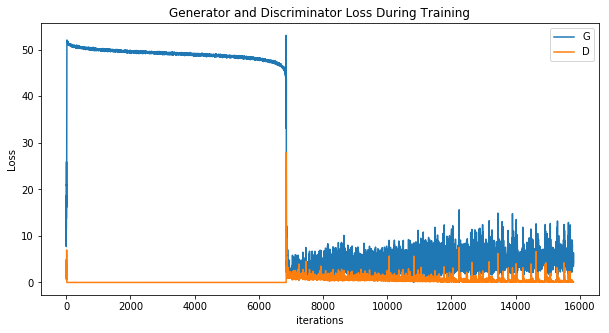

In [11]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 25183759 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


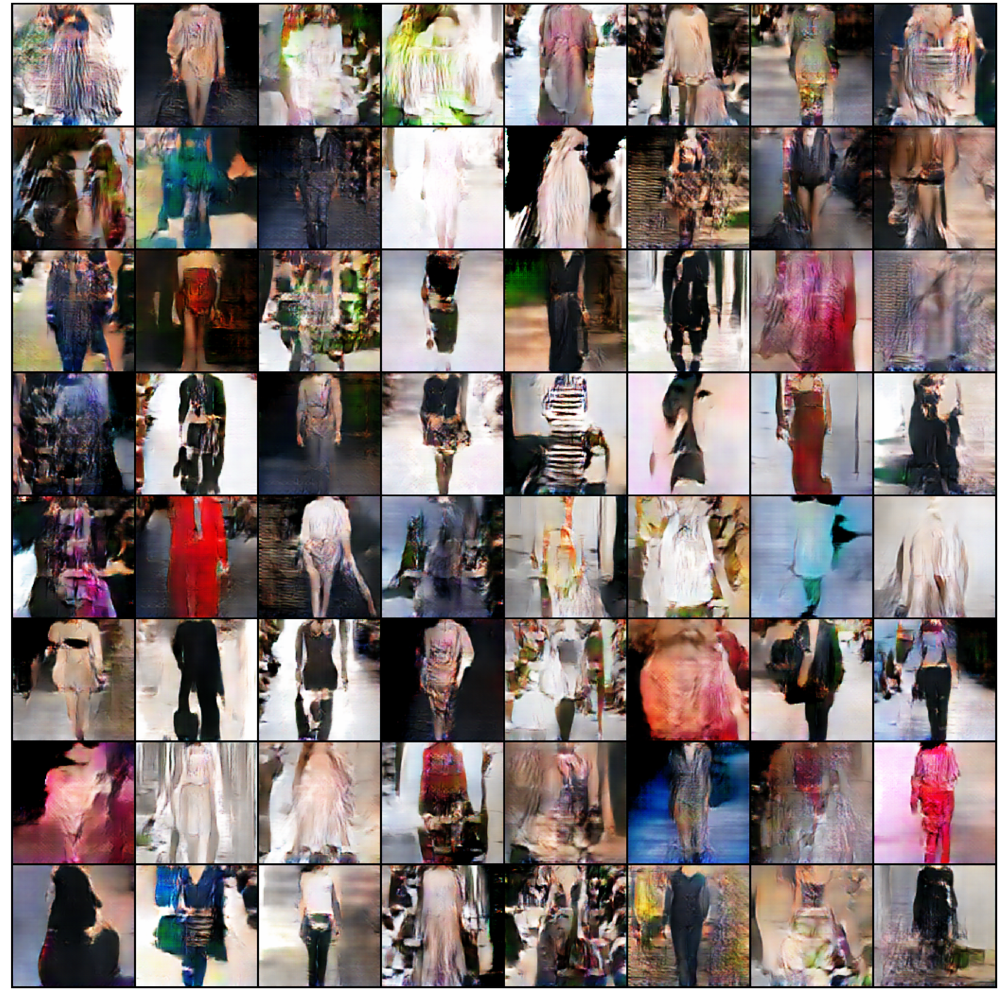

In [12]:
fig = plt.figure(figsize=(64,64))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

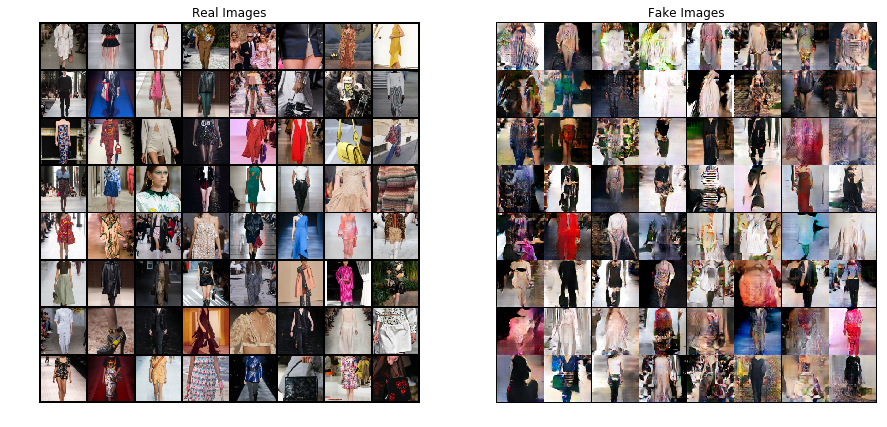

In [13]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

In [14]:
for image in range(len(img_list)):
    name = "generated_fourthrun" + str(image) +".jpg"
    print(name)
    plt.imsave(name, np.transpose(img_list[image],(1,2,0)), format='jpg')

generated_thirdrun0.jpg
generated_thirdrun1.jpg
generated_thirdrun2.jpg
generated_thirdrun3.jpg
generated_thirdrun4.jpg
generated_thirdrun5.jpg
generated_thirdrun6.jpg
generated_thirdrun7.jpg
generated_thirdrun8.jpg
generated_thirdrun9.jpg
generated_thirdrun10.jpg
generated_thirdrun11.jpg
generated_thirdrun12.jpg
generated_thirdrun13.jpg
generated_thirdrun14.jpg
generated_thirdrun15.jpg
generated_thirdrun16.jpg
generated_thirdrun17.jpg
generated_thirdrun18.jpg
generated_thirdrun19.jpg
generated_thirdrun20.jpg
generated_thirdrun21.jpg
generated_thirdrun22.jpg
generated_thirdrun23.jpg
generated_thirdrun24.jpg
generated_thirdrun25.jpg
generated_thirdrun26.jpg
generated_thirdrun27.jpg
generated_thirdrun28.jpg
generated_thirdrun29.jpg
generated_thirdrun30.jpg
generated_thirdrun31.jpg
generated_thirdrun32.jpg
